#Import Lib

In [ ]:
!pip install spotipy

In [ ]:
import spotipy
import os
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from yellowbrick.target import FeatureCorrelation
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score,r2_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from tqdm import tqdm
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import ExtraTreesRegressor
%matplotlib inline

#Data Aanalysis

In [ ]:
data = pd.read_csv('data/data.csv')
data_w_genres = pd.read_csv('data/data_w_genres.csv')

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning:

From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.



FeatureCorrelation(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7f07e9e91690>,
                   feature_index=None, feature_names=None,
                   labels=array(['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence',
       'duration_ms', 'explicit', 'key', 'mode', 'year'], dtype='<U16'),
                   method='pearson', sort=False)

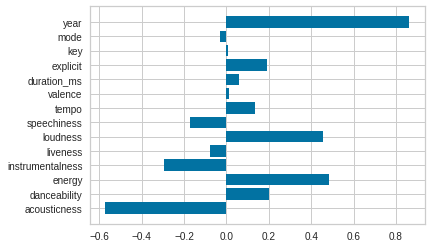

In [ ]:
#find correlation between each attribute and popularity
attributes = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']
x = data[attributes]
y = data['popularity']
features = np.array(attributes)
visualizer = FeatureCorrelation(labels=features)
plt.rcParams['figure.figsize']=(10,10)
visualizer.fit(x,y)
#plt.rcParams.keys()
# year, acc,danceability, energy, loudness and tempo ,explicit,inst,energy,sp,are important

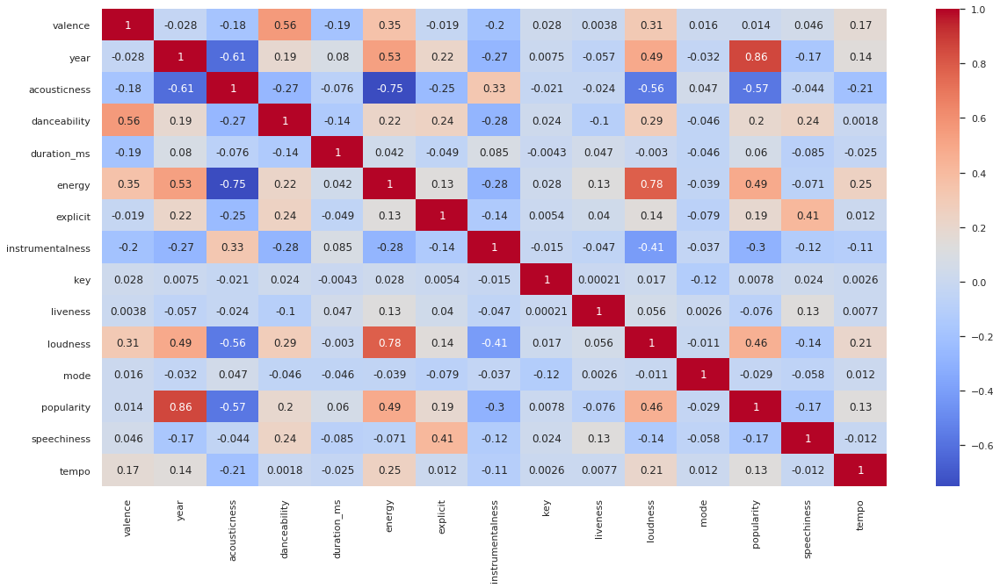

In [ ]:
#find correlation between each attribute
plt.figure(figsize=(20,10))
sns.set(style="whitegrid")
corr = data.corr()
sns.heatmap(corr,annot=True,cmap="coolwarm",annot_kws={"size":12})

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/di

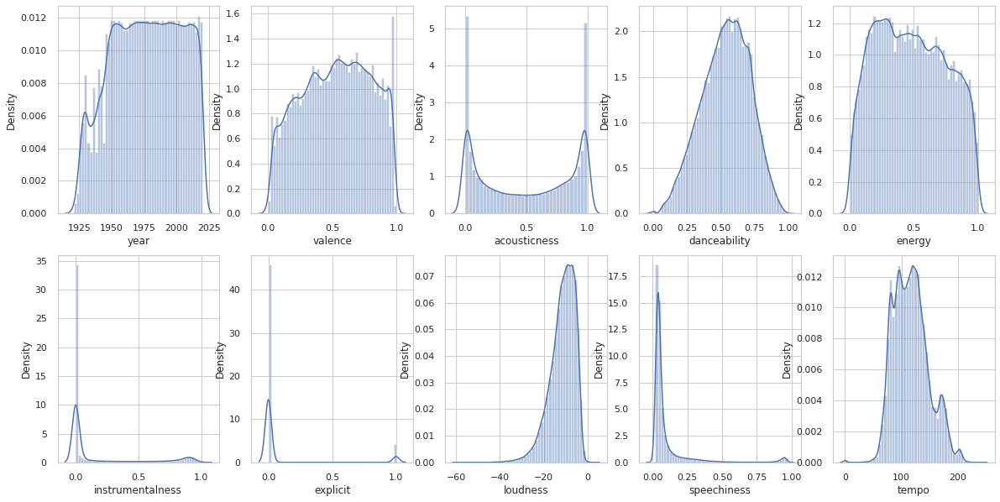

In [ ]:
#year,acousticness,danceability,energy,instrumentalness,loudness,tempo,explicit,energy,speechiness,are important
#針對準備用的att 檢查資料分布
#Visualisation
fig,ax = plt.subplots(2,5,figsize=(20,10))
sns.distplot(data['year'],ax=ax[0,0])
sns.distplot(data['valence'],ax=ax[0,1])
sns.distplot(data['acousticness'],ax=ax[0,2])
sns.distplot(data['danceability'],ax=ax[0,3])
sns.distplot(data['energy'],ax=ax[0,4])
sns.distplot(data['instrumentalness'],ax=ax[1,0])
sns.distplot(data['explicit'],ax=ax[1,1])
sns.distplot(data['loudness'],ax=ax[1,2])
sns.distplot(data['speechiness'],ax=ax[1,3])
sns.distplot(data['tempo'],ax=ax[1,4])

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



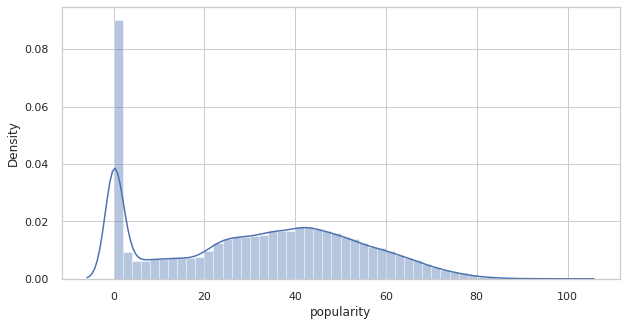

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.distplot(data['popularity'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning

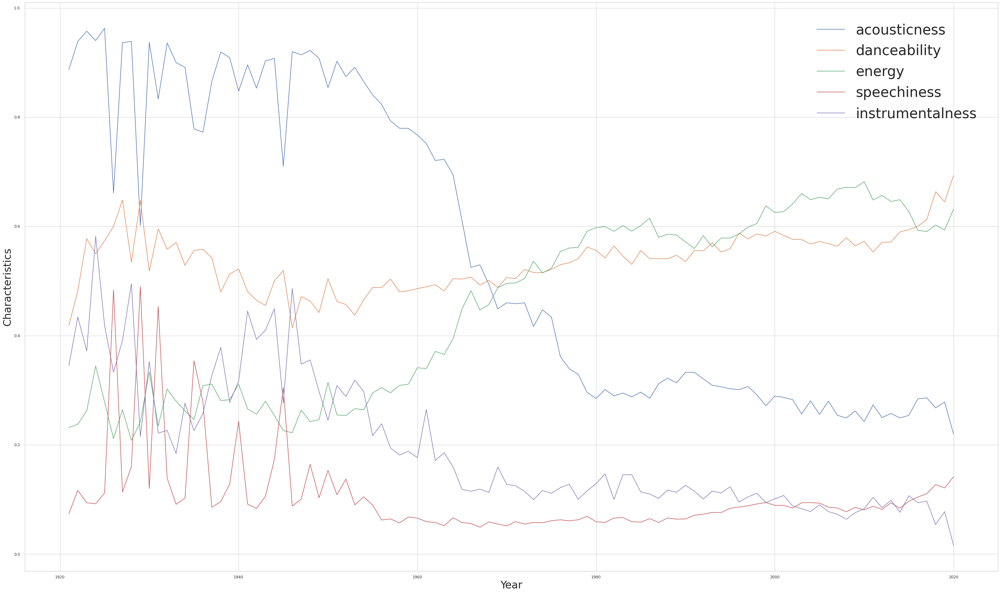

In [ ]:
#some detail of corr
columns = ["acousticness","danceability","energy","speechiness","instrumentalness"]
plt.figure(figsize=(50,30))
for c in columns:
    x = data.groupby('year')[c].mean()
    sns.lineplot(x.index,x,label=c)
plt.xlabel('Year',fontsize=30)
plt.ylabel('Characteristics',fontsize=30)
plt.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1, prop={'size': 40}, loc = 'upper right')
plt.show()

In [ ]:
data_by_genres = pd.read_csv('data/data_by_genres.csv')
data_by_genres.keys()

Index(['mode', 'genres', 'acousticness', 'danceability', 'duration_ms',
       'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness',
       'tempo', 'valence', 'popularity', 'key'],
      dtype='object')

In [ ]:
data_by_genres['genres'].value_counts()

crust punk                   1
traditional rockabilly       1
italian contemporary jazz    1
beat poetry                  1
khaleeji iraqi               1
                            ..
otacore                      1
steel guitar                 1
afroswing                    1
underground rap              1
new orleans jazz             1
Name: genres, Length: 2973, dtype: int64

In [ ]:
print(len(data_by_genres['genres'].value_counts()))

2973


#Predict popularity

In [ ]:
imp_attributes = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'loudness', 'speechiness', 'tempo', 'valence','explicit','year','popularity']
df = pd.read_csv('data/data.csv', usecols=imp_attributes)
df.head()

,valence,year,acousticness,danceability,energy,explicit,instrumentalness,loudness,popularity,speechiness,tempo
0,0.0594,1921,0.982,0.279,0.211,0,0.878000,-20.096,4,0.0366,80.954
1,0.9630,1921,0.732,0.819,0.341,0,0.000000,-12.441,5,0.4150,60.936
2,0.0394,1921,0.961,0.328,0.166,0,0.913000,-14.850,5,0.0339,110.339
3,0.1650,1921,0.967,0.275,0.309,0,0.000028,-9.316,3,0.0354,100.109
4,0.2530,1921,0.957,0.418,0.193,0,0.000002,-10.096,2,0.0380,101.665


In [ ]:
#predict popularity by ML
x = df.drop(columns=['popularity'])
y = df['popularity']
x_train,x_val,y_train,y_val = train_test_split(x,y,test_size=0.2)

In [ ]:
model_predict_popularity = RandomForestRegressor(verbose=2)
model_predict_popularity.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 100


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s remaining:    0.0s


building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 42 of 100
building tree 43 of 100


[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  2.4min finished


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=2, warm_start=False)

In [ ]:
y_pred = model_predict_popularity.predict(x_val)
r2_score(y_val,y_pred)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    2.0s finished


0.8064987704582028

In [ ]:
mean_absolute_error(y_val,y_pred)

6.818409684053637

In [ ]:
model = ExtraTreesRegressor(n_estimators=100, random_state=0,verbose = 2)
model.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 100


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s


building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 42 of 100
building tree 43 of 100


[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:   50.1s finished


ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=None, oob_score=False,
                    random_state=0, verbose=2, warm_start=False)

In [ ]:
y_pred = model.predict(x_val)
r2_score(y_val,y_pred)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    2.3s finished


0.8042252040290571

In [ ]:
mean_absolute_error(y_val,y_pred)

6.833030246673299

#Song's Genres Classifier 

In [ ]:
data = pd.read_csv('data/data.csv')

In [ ]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])
x = data_by_genres.select_dtypes(np.number)
cluster_pipeline.fit(x)
data_by_genres['cluster'] = cluster_pipeline.predict(x)

In [ ]:
tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(x)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = data_by_genres['genres']
projection['cluster'] = data_by_genres['cluster']
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.008s...
[t-SNE] Computed neighbors for 2973 samples in 0.356s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.160s
[t-SNE] Iteration 50: error = 81.9721375, gradient norm = 0.0084809 (50 iterations in 1.599s)
[t-SNE] Iteration 100: error = 76.5784302, gradient norm = 0.0106324 (50 iterations in 1.365s)
[t-SNE] Iteration 150: error = 76.2134247, gradient norm = 0.0037205 (50 iterations in 1.131s)
[t-SNE] Iteration 200: error = 76.1413803, gradient norm = 0.0015489 (50 iterations in 1.150s)
[t-SNE] Iteration 250: error = 76.1178436, gradient norm = 0.0003551 (50 iterations in 1.132s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.117844
[t-SNE] Iteration 300: erro

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),('kmeans', KMeans(n_clusters=20,verbose=2, n_jobs=4))],verbose=True)

x = data.select_dtypes(np.number)
number_cols = list(x.columns)
song_cluster_pipeline.fit(x)
song_cluster_labels = song_cluster_pipeline.predict(x)
data['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  39.1s


In [ ]:
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(x)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [ ]:
data_by_genres0 = pd.read_csv('data/data_by_genres.csv')
data_by_genres0['genres']

0       21st century classical
1                        432hz
2                        8-bit
3                           []
4                   a cappella
                 ...          
2968                      zolo
2969                   zouglou
2970                      zouk
2971              zurich indie
2972                    zydeco
Name: genres, Length: 2973, dtype: object

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
x = data_by_genres0.drop(columns=['genres'])
y = data_by_genres0['genres']
x_train,x_val,y_train,y_val = train_test_split(x,y,test_size=0.2)
knn_model = KNeighborsClassifier(n_neighbors=10)
knn_model.fit(x_train,y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                     weights='uniform')

In [ ]:
y_pred = knn_model.predict(x_val)
knn_model.score(x_val,y_val)

0.0

#My Recommendation System with CF

In [ ]:
# cosine metric
data_0 = pd.read_csv('data/data.csv')
data_0 = data_0.drop(labels=['explicit'],axis=1)

In [ ]:
import math
class Song_Recommender():
    def __init__(self, data):
        self.data_ = data
    def get_recommendations(self, song_name, n_top):
        distances = []
        song = self.data_[(self.data_.name.str.lower() == song_name.lower())].head(1).values[0]
        rem_data = self.data_[self.data_.name.str.lower() != song_name.lower()]
        for r_song in tqdm(rem_data.values):
            dist = 0
            cos_sim = 0
            song_sq = 0
            r_song_sq = 0
            dot = 0
            for col in np.arange(len(rem_data.columns)):
                if not col in [3,7,13,15]:
                  song_sq += float(song[col])**2
                  r_song_sq += float(r_song[col])**2
                  dot += float(song[col]) * float(r_song[col])
                  dist = dist + np.absolute(float(song[col]) - float(r_song[col]))
            cos_sim = dot/(math.sqrt(song_sq) * math.sqrt(r_song_sq))
            #if cos_sim<0:print(cos_sim)

            distances.append(dist)
        rem_data['distance'] = distances
        rem_data = rem_data.sort_values('distance')
        columns = ['artists', 'name']
        return rem_data[columns][:n_top]

In [ ]:
num_types = ['int', 'float']
num = data_0.select_dtypes(include=num_types)
for col in num.columns:
  data_0[col] = (data_0[col] - data_0[col].min())/(data_0[col].max() - data_0[col].min())

In [ ]:
recommender = Song_Recommender(data_0)
recommender.get_recommendations('In My Feelings', 5) # Drake: In My Feelings, trap

100%|██████████| 170650/170650 [00:15<00:00, 10888.22it/s]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,artists,name
18850,"['Drake', 'WizKid', 'Kyla']",One Dance
17621,"['Trey Songz', 'Nicki Minaj']",Bottoms Up (feat. Nicki Minaj)
91803,['Eminem'],Greatest
170507,"['Eminem', 'Young M.A']",Unaccommodating (feat. Young M.A)
18625,"['Big Sean', 'E-40']",I Don't Fuck With You


In [ ]:
recommender.get_recommendations('Away with the Fairies', 5)

100%|██████████| 170652/170652 [00:15<00:00, 11120.01it/s]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,artists,name
170128,['Fujitsu'],sand castles
123823,['Wun Two'],Sk8teing in Central Park
37778,['[bsd.u]'],French Inhale
154568,['Dramadigs'],Schehmetmoll
169035,['Parov Stelar'],All Night


#Spotify API and Recommendation System On Kaggle

In [ ]:
os.environ["SPOTIFY_CLIENT_ID"] = "95187a9c1a714bab9f91b9178549c113"
os.environ["SPOTIFY_CLIENT_SECRET"] = "b7c6951b5b5a4aa2a877859a46d39833"
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
            client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value
    #print(results['artists'][0]['name'])
    return pd.DataFrame(song_data)
 

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=11):
    
    metadata_cols = ['artists','name']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols]

In [ ]:
recommend_songs([{'name': 'In My Feelings', 'year':2018}],data,6)

,artists,name
170507,"['Eminem', 'Young M.A']",Unaccommodating (feat. Young M.A)
17621,"['Trey Songz', 'Nicki Minaj']",Bottoms Up (feat. Nicki Minaj)
91803,['Eminem'],Greatest
38383,"['DaBaby', 'Offset']",Baby Sitter (feat. Offset)
18625,"['Big Sean', 'E-40']",I Don't Fuck With You


In [ ]:
recommend_songs([{'name': 'Away with the Fairies', 'year':2018}],data,6)

,artists,name
37778,['[bsd.u]'],French Inhale
67054,['Young Marble Giants'],Brand - New - Life
123823,['Wun Two'],Sk8teing in Central Park
105922,['Pérez Prado'],Mambo No 5
19188,"['itssvd', 'Shiloh Dynasty']",Losing Interest
